# Assignment Requirements


> Complete an Exploratory data analysis for the dataset of your choosing.
> Define a few questions that you wish to discover about your dataset to guide your EDA effort.    

# I. Introduction and Setup

## I.1 Introduction

While exploring Data.Gov, I eventually discovered *The Atlas of Rural and Small-Town America* [(References: Data.Gov, 2021)](#Z.-References) which provides statistics for broad categories of socioeconomic factors:
 
* **County classifications**:    
    Categorical variables including the rural-urban continuum codes, economic dependence codes, persistent poverty, persistent child poverty, population loss, onshore oil/natural gas counties, and other ERS county typology codes.
* **Income**:    
    Data on median household income, per capita income, and poverty (including child poverty).
* Additional data is provided, but adding that data to the analysis proved to be beyond my capabilities at this time.

I also found *Creative Class County Codes*, a separate data set available from [USDA.Gov (n.d. 2)](#Z.-References) which attempts to enumerate a county's share of population employed in occupations that require "thinking creatively", as defined by the USDA.

## I.2 Questions

1. Is there a relationship between a county's share of the "creative class" and the county's income?
2. Likewise, is there a relationship between the share of "creative class" and the county's score on the Rural/Urban Continuum Code? [(Definitions)](#III.-Definitions)

**NOTE**: I did not evaluate the mechanism that the USDA used to characterize the creative class


## I.3 Python Setup

In [102]:
import datetime
import math
import matplotlib.pylab as plt
import matplotlib.pyplot
import numpy as np
import pandas as pd
import seaborn as sns
import sklearn.linear_model
import sklearn.metrics
import sklearn.model_selection
import scipy
import scipy.stats
import statsmodels.api as sm
import unicodedata
%matplotlib inline

pd.set_option('max_row', 100)

# After going thru this data set multiple times, I've found it convenient to
# declare a list of commonly used columns which describe (but don't measure)
# a county
DESCRIPTOR_COLS = ['FIPS', 'State', 'County']

In [103]:
!file 'data/assign_wk3/County Classifications.csv' 'data/assign_wk3/Income.csv' 'data/assign_wk3/creativeclass200711.csv'

data/assign_wk3/County Classifications.csv: ISO-8859 text, with very long lines, with CRLF line terminators
data/assign_wk3/Income.csv:                 CSV text
data/assign_wk3/creativeclass200711.csv:    CSV text


In [104]:
# Based on the output below, there is clearly a mismatch in the number of
# counties ... this will need to be investigated
!wc -l  'data/assign_wk3/County Classifications.csv' 'data/assign_wk3/Income.csv' 'data/assign_wk3/creativeclass200711.csv'

   3226 data/assign_wk3/County Classifications.csv
   3279 data/assign_wk3/Income.csv
   3147 data/assign_wk3/creativeclass200711.csv
   9652 total


## I.4 Acquire Data

### I.4.1 Acquire Data - **Income**

In [105]:
income_df = pd.read_csv('data/assign_wk3/Income.csv')
income_df.head()

,FIPS,State,County,Median_HH_Inc_ACS,PerCapitaInc,Poverty_Rate_0_17_ACS,Poverty_Rate_ACS,Deep_Pov_All,Deep_Pov_Children,NumAll_inPOV_ACS,PCTPOV017,POV017,MedHHInc,POVALL,PCTPOVALL,Num_inPOV_0_17_ACS
0,0,US,United States,62843.0,34103.0,18.519621,13.422426,5.985652,8.155789,42510843.0,16.8,12000470.0,65712.0,39490096.0,12.3,13377778.0
1,1000,AL,Alabama,50536.0,27928.0,23.900209,16.742549,7.410636,11.152622,795989.0,21.9,233890.0,51771.0,747478.0,15.6,258068.0
2,1001,AL,Autauga,58731.0,29819.0,23.215238,15.185172,6.261607,9.592381,8340.0,15.9,2040.0,58233.0,6723.0,12.1,3047.0
3,1003,AL,Baldwin,58320.0,32626.0,13.364308,10.354073,4.046885,5.656490,21704.0,13.5,6323.0,59871.0,22360.0,10.1,6098.0
4,1005,AL,Barbour,32525.0,18473.0,50.142884,30.668689,15.042156,31.491713,6875.0,41.0,2050.0,35972.0,5909.0,27.1,2632.0


In [106]:
# From the `wc -l` command above, we expect 3278 rows
# (3279 - 1, for the header row)
income_df.shape

(3278, 16)

### I.4.2 Acquire Data - **Creative Class**

In [107]:
cc_df = pd.read_csv('data/assign_wk3/creativeclass200711.csv')
cc_df.head()

,FIPS,State,State abr.,County,metro03,TotEmpEst,TotEmpSE,CCEst,CCSE,CCShare,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
0,1001,Alabama,AL,Autauga County,1,24140,390.27,5680,318.54,0.23529,0.01264,140,40.73,0.0058,0.00168,642,524,67,0.02079,0.00277
1,1003,Alabama,AL,Baldwin County,0,79965,910.03,20535,637.08,0.2568,0.00741,835,137.99,0.010442,0.00172,1497,1048,227,0.01219,0.00283
2,1005,Alabama,AL,Barbour County,0,9635,369.6,1485,155.62,0.15413,0.01503,45,25.53,0.00467,0.00264,608,256,42,0.02473,0.00435
3,1007,Alabama,AL,Bibb County,1,9355,319.76,1355,203.65,0.14484,0.0212,15,15.81,0.001603,0.00169,526,335,26,0.03487,0.00278
4,1009,Alabama,AL,Blount County,1,24175,433.43,4090,288.15,0.16918,0.01153,95,46.81,0.00393,0.00193,713,474,77,0.01896,0.00318


In [108]:
# From the `wc -l` command above, we expect 3146 rows
# (3147 - 1, for the header row)
cc_df.shape

(3146, 20)

### I.4.3 Acquire Data - **County Classification**

In [109]:
# Based on the output of the `file` command above, we expect
# 'County Classifications.csv' to use ISO-8859 encoding.
#
# Also, this particular file is tab delimited
county_classifications_df = pd.read_csv('data/assign_wk3/County Classifications.csv', sep='\t', encoding='ISO-8859-1')
county_classifications_df.head()

,FIPStxt,State,County,RuralUrbanContinuumCode2013,UrbanInfluenceCode2013,RuralUrbanContinuumCode2003,UrbanInfluenceCode2003,Metro2013,Nonmetro2013,Micropolitan2013,...,FarmDependent2003,ManufacturingDependent2000,LowEducation2000,RetirementDestination2000,PersistentPoverty2000,Noncore2013,Type_2015_Nonspecialized_NO,Metro_Adjacent2013,PersistentChildPoverty2004,RecreationDependent2000
0,1001,AL,Autauga,2.0,2.0,2.0,2.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,1003,AL,Baldwin,3.0,2.0,4.0,5.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
2,1005,AL,Barbour,6.0,6.0,6.0,6.0,0.0,1.0,0.0,...,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0
3,1007,AL,Bibb,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0
4,1009,AL,Blount,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0


In [110]:
# From the `wc -l` command above, we expect 3225 rows
# (3226 - 1, for the header row)
county_classifications_df.shape

(3225, 45)

---

# 1. Data Description

## 1.1 Data Description - **Income**

### 1.1.1 **Income** - Data Types, Categorical vs Continuous variables

In [111]:
# I already know that `State` and `County` should be string
# (but default to object):
income_df['State'] = pd.Series(income_df.State, dtype='string')
income_df['County'] = pd.Series(income_df.County, dtype='string')

income_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3278 entries, 0 to 3277
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   FIPS                   3278 non-null   int64  
 1   State                  3278 non-null   string 
 2   County                 3278 non-null   string 
 3   Median_HH_Inc_ACS      3273 non-null   float64
 4   PerCapitaInc           3273 non-null   float64
 5   Poverty_Rate_0_17_ACS  3272 non-null   float64
 6   Poverty_Rate_ACS       3273 non-null   float64
 7   Deep_Pov_All           3273 non-null   float64
 8   Deep_Pov_Children      3273 non-null   float64
 9   NumAll_inPOV_ACS       3273 non-null   float64
 10  PCTPOV017              3193 non-null   float64
 11  POV017                 3193 non-null   float64
 12  MedHHInc               3193 non-null   float64
 13  POVALL                 3193 non-null   float64
 14  PCTPOVALL              3193 non-null   float64
 15  Num_

### 1.1.2 **Income** - Statistical summary, etc.

In [112]:
INCOME_COLS = [c for c in income_df.columns.to_list() if c not in DESCRIPTOR_COLS]

income_df[INCOME_COLS].describe().T

,count,mean,std,min,25%,50%,75%,max
Median_HH_Inc_ACS,3273.0,52804.180568,14994.475954,12441.000000,43629.000000,51620.000000,59795.000000,1.422990e+05
PerCapitaInc,3273.0,27753.176291,7227.349965,6118.000000,23448.000000,27230.000000,31248.000000,7.659200e+04
Poverty_Rate_0_17_ACS,3272.0,21.631068,11.773653,0.000000,13.760646,19.686689,26.946035,8.310199e+01
Poverty_Rate_ACS,3273.0,15.858164,8.051816,2.428811,10.712916,14.334035,18.766075,6.449383e+01
Deep_Pov_All,3273.0,6.935700,4.493722,0.000000,4.354839,5.972603,7.939294,4.498765e+01
Deep_Pov_Children,3273.0,9.861485,7.731488,-99.000000,5.302578,8.325482,12.170582,7.293103e+01
NumAll_inPOV_ACS,3273.0,39850.507485,761235.778793,6.000000,1647.000000,4104.000000,10777.000000,4.251084e+07
PCTPOV017,3193.0,19.903132,8.464877,2.400000,13.600000,18.600000,24.800000,6.340000e+01
POV017,3193.0,11275.104604,217654.502934,5.000000,474.000000,1113.000000,2811.000000,1.200047e+07
MedHHInc,3193.0,55874.761979,14493.345229,24732.000000,46309.000000,53505.000000,62327.000000,1.518060e+05


### 1.1.3 Intermediate analysis of **`income_df`** Data Frame

* [x] The DataFrame imported correctly and appears to have reasonable data types for all columns    
      We expect values such as income and percentages to be continuous (`float64`)
* [ ] There are almost 100 null values in several of the columns
* [ ] Some of the percentage max values might need further investigation    
      It's possible that a county has a *Poverty Rate for Ages 0-17* of `83%`, but this should be verified

## 1.2 Data Description - Creative Class

### 1.2.1 **Creative Class** - Data Types

In [113]:
# Based on the output of cc_df.head above, we know that this DF has both 'State'
# (fully spelled out) and 'State abr.'
cc_df['State'] = cc_df['State abr.']
cc_df.drop(columns=['State abr.'], inplace=True)

# I already know that `State` and `County` should be string (default to object):
cc_df['State'] = pd.Series(cc_df.State, dtype='string')
cc_df['County'] = pd.Series(cc_df.County, dtype='string')

cc_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3146 entries, 0 to 3145
Data columns (total 19 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   FIPS         3146 non-null   int64 
 1   State        3142 non-null   string
 2   County       3142 non-null   string
 3   metro03      3146 non-null   object
 4   TotEmpEst    3146 non-null   object
 5   TotEmpSE     3146 non-null   object
 6   CCEst        3146 non-null   object
 7   CCSE         3146 non-null   object
 8   CCShare      3146 non-null   object
 9   CCShareSE    3146 non-null   object
 10  BohEST       3146 non-null   object
 11  BohSE        3146 non-null   object
 12  BohShare     3146 non-null   object
 13  BohShareSE   3146 non-null   object
 14  TotEmpRME    3146 non-null   object
 15  CCRME        3146 non-null   object
 16  BohRME       3146 non-null   object
 17  CCShareRME   3146 non-null   object
 18  BohShareRME  3146 non-null   object
dtypes: int64(1), object(16), st

In [114]:
# The cc_df.info above does not look correct.  Columns 4 - 18 should be float64

# I also noticed in the raw creativeClass200711.csv file that several rows
# consisted only of '.'
cc_df[cc_df.State.isna()]

,FIPS,State,County,metro03,TotEmpEst,TotEmpSE,CCEst,CCSE,CCShare,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
87,2231,<NA>,<NA>,.,.,.,.,.,.,.,.,.,.,.,.,.,.,.,.
250,8014,<NA>,<NA>,1,.,.,.,.,.,.,.,.,.,.,.,.,.,.,.
331,12025,<NA>,<NA>,.,.,.,.,.,.,.,.,.,.,.,.,.,.,.,.
1654,30113,<NA>,<NA>,.,.,.,.,.,.,.,.,.,.,.,.,.,.,.,.


In [115]:
# Do these counties exist in (e.g.) income_df?
income_df[income_df.FIPS.isin([2231, 8014, 12025, 30113])][DESCRIPTOR_COLS]

,FIPS,State,County
262,8014,CO,Broomfield


A quick analysis of the FIPS codes from the output above shows the following

| FIPS Code | County Name               | State | Analysis                  |
|:----------|:--------------------------|:------|:--------------------------|
| 2231      | Skagway-Yakutat-Angoon    | AK    | Split/absorbed in 1992    |
| 8014      | Broomfield                | CO    | Created in 2001           |
| 12025     | Dade                      | FL    | Renamed/recoded in 1997   |
| 30113     | Yellowstone National Park | MT    | Absorbed in 1997          |

In [116]:
# Based on the above analysis, we can safely drop the removed/renamed
# counties (but we'll keep Broomfield and see if we can impute some data later)
#
# This might be considered early cleaning, but the goal is to have reasonable
# data types for the columns, and we need to achieve 'float64' values for
# the bulk of this data frame
cc_df.drop(index=cc_df[cc_df.FIPS.isin([2231, 12025, 30113])].index, inplace=True)

cc_df.at[cc_df[cc_df.FIPS == 8014].index, 'State'] = 'CO'
cc_df.at[cc_df[cc_df.FIPS == 8014].index, 'County'] = 'Broomfield'

# Now, let's attempt to convert these columns to numeric instead of 'object'
object_cols = [
    'metro03',
    'TotEmpEst',
    'TotEmpSE',
    'CCEst',
    'CCSE',
    'CCShare',
    'CCShareSE',
    'BohEST',
    'BohSE',
    'BohShare',
    'BohShareSE',
    'TotEmpRME',
    'CCRME',
    'BohRME',
    'CCShareRME',
    'BohShareRME'
    ]

# By using "errors=coerce", any failed conversion will be NaN
for c in object_cols:
    cc_df[c] = pd.to_numeric(cc_df[c], errors='coerce')


cc_df[cc_df.isna().any(axis='columns')]

,FIPS,State,County,metro03,TotEmpEst,TotEmpSE,CCEst,CCSE,CCShare,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
250,8014,CO,Broomfield,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2922,51560,VA,Clifton Forge city,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2950,51780,VA,South Boston City,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [117]:
cc_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3143 entries, 0 to 3145
Data columns (total 19 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   FIPS         3143 non-null   int64  
 1   State        3143 non-null   string 
 2   County       3143 non-null   string 
 3   metro03      3142 non-null   float64
 4   TotEmpEst    3140 non-null   float64
 5   TotEmpSE     3140 non-null   float64
 6   CCEst        3140 non-null   float64
 7   CCSE         3140 non-null   float64
 8   CCShare      3140 non-null   float64
 9   CCShareSE    3140 non-null   float64
 10  BohEST       3140 non-null   float64
 11  BohSE        3140 non-null   float64
 12  BohShare     3140 non-null   float64
 13  BohShareSE   3140 non-null   float64
 14  TotEmpRME    3140 non-null   float64
 15  CCRME        3140 non-null   float64
 16  BohRME       3140 non-null   float64
 17  CCShareRME   3140 non-null   float64
 18  BohShareRME  3140 non-null   float64
dtypes: flo

### 1.2.2 **Creative Class** - Statistical summary, etc.

In [118]:
CC_COLS = [c for c in cc_df.columns.to_list() if c not in DESCRIPTOR_COLS]

cc_df[CC_COLS].describe().T

,count,mean,std,min,25%,50%,75%,max
metro03,3142.0,0.346913,0.476063,0.00000,0.000000,0.000000,1.000000,1.000000e+00
TotEmpEst,3140.0,45159.399682,145433.820514,45.00000,4622.500000,10840.000000,29521.250000,4.501380e+06
TotEmpSE,3140.0,384.748599,392.569095,11.55000,158.660000,273.250000,459.570000,5.238300e+03
CCEst,3140.0,11571.240446,41792.849256,10.00000,685.000000,1857.500000,5858.750000,1.230895e+06
CCSE,3140.0,263.245468,322.133593,7.29000,89.970000,160.490000,297.260000,4.192710e+03
CCShare,3140.0,0.184552,0.059971,0.03320,0.143543,0.172115,0.212983,5.122300e-01
CCShareSE,3140.0,0.014761,0.009209,0.00088,0.008707,0.013200,0.018670,1.517400e-01
BohEST,3140.0,515.473885,2842.276875,0.00000,15.000000,65.000000,231.250000,1.216200e+05
BohSE,3140.0,61.157175,83.720624,0.61000,18.840000,40.730000,64.440000,1.750760e+03
BohShare,3140.0,0.006842,0.005538,0.00000,0.003152,0.006146,0.009362,6.521700e-02


### 1.2.3 Intermediate analysis of **`cc_df`** Data Frame

* [x] The DataFrame initially had incorrect data types (object vice float), but these have been corrected
* [ ] There are still a few null values in several of the columns
* [ ] The metro03 column (currently of type `float64` ) is actually categorical    
      `1` is metro, `0` is non-metro; however this column ends up being redundant with the County Classifications (next Data Frame)

## 1.3 Data Description - **County Classifications**

### 1.3.1 **County Classifications** - Data Types

In [119]:
# Clean up column names
county_classifications_df.rename(columns={'FIPStxt': 'FIPS'}, inplace=True)

# Fix the types:
county_classifications_df['State'] = pd.Series(county_classifications_df.State, dtype='string')
county_classifications_df['County'] = pd.Series(county_classifications_df.County, dtype='string')

county_classifications_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3225 entries, 0 to 3224
Data columns (total 45 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   FIPS                                3225 non-null   int64  
 1   State                               3225 non-null   string 
 2   County                              3225 non-null   string 
 3   RuralUrbanContinuumCode2013         3221 non-null   float64
 4   UrbanInfluenceCode2013              3221 non-null   float64
 5   RuralUrbanContinuumCode2003         3224 non-null   float64
 6   UrbanInfluenceCode2003              3224 non-null   float64
 7   Metro2013                           3221 non-null   float64
 8   Nonmetro2013                        3221 non-null   float64
 9   Micropolitan2013                    3221 non-null   float64
 10  Type_2015_Update                    3143 non-null   float64
 11  Type_2015_Farming_NO                3143 no

### 1.2.2 **County Codes** - Statistical summary, etc.

In [120]:
county_classifications_df.describe().T

,count,mean,std,min,25%,50%,75%,max
FIPS,3225.0,31363.611473,16315.749378,1001.0,19027.0,30021.0,46105.0,72153.0
RuralUrbanContinuumCode2013,3221.0,4.936976,2.724413,1.0,2.0,6.0,7.0,9.0
UrbanInfluenceCode2013,3221.0,5.187830,3.506753,1.0,2.0,5.0,8.0,12.0
RuralUrbanContinuumCode2003,3224.0,5.061104,2.702831,1.0,3.0,6.0,7.0,9.0
UrbanInfluenceCode2003,3224.0,5.378722,3.488227,1.0,2.0,5.0,8.0,12.0
Metro2013,3221.0,0.383732,0.486369,0.0,0.0,0.0,1.0,1.0
Nonmetro2013,3221.0,0.616268,0.486369,0.0,0.0,1.0,1.0,1.0
Micropolitan2013,3221.0,0.200559,0.400481,0.0,0.0,0.0,0.0,1.0
Type_2015_Update,3143.0,1.807827,1.819507,0.0,0.0,1.0,3.0,5.0
Type_2015_Farming_NO,3143.0,0.141266,0.348351,0.0,0.0,0.0,0.0,1.0


### 1.2.3 Intermediate analysis of **`county_classifications_df`** Data Frame

* [ ] RuralUrbanContinuumCode2013 (and possibly other measures) needs to be converted to categorical (ordinal) values (`int64`)
      According to [USDA.gov (n.d.)](#Z.-References) countly classifications are *levels* or *categories* (ranging from 1-9 on a scale, meaning they're *ordinal*).
* [ ] The values, overall, look good but there are significant redundancies 
      RuralUrbanContinuumCode2013 vs RuralUrbanContinuumCode2003, depending on the ultimate focus of the analysis


---

# 2. Data Cleaning

## 2.1 Combine the Data

In [121]:
# Prior to combining the data sets, we need to fix inconsistencies in the
# naming of counties (e.g.,  "Autauga County" should be "Autauga", "LaSalle"
# vs "La Salle")
county_name_special_cases = {
    'Charles City': 'Charles City',
    'James City' : 'James City',
    'La Salle County': 'LaSalle',
    'La Salle Parish': 'LaSalle',
    'La Salle': 'LaSalle'
    }

suffixes = ['county', 'parish', 'city', 'borough', 'census', 'municipality']


def clean_county_name(value):
    # Handle special cases first... if 'value' is not a key in the dict
    # an exception will be thrown and we will fall thru to the next phase
    try:
        return county_name_special_cases[value]
    except KeyError:
        pass

    # Remove the redundant suffixes, if present
    for suffix in suffixes:
        suffix = ' ' + suffix
        location = value.lower().find(suffix.lower())
        if location >= 0:
            value = value[:location]
            break

    # Trim leading/trailing whitespace
    value = value.strip()

    # Remove accented characters
    value = unicodedata.normalize('NFKD', value).encode('ascii', 'ignore').decode('utf-8')

    return value
    

cc_df['County'] = cc_df.County.apply(lambda x: clean_county_name(x))
county_classifications_df['County'] = county_classifications_df.County.apply(lambda x: clean_county_name(x))
income_df['County'] = income_df.County.apply(lambda x: clean_county_name(x))

# As mentioned in 1.2.3, County Classifications has a significant quantity of
# redundant data
for c in county_classifications_df.columns:
    if county_classifications_df[c].isna().sum() >= 5:
        county_classifications_df.drop(columns=c, inplace=True)

# Now, merge the data
df = county_classifications_df.merge(income_df, how='left', on=DESCRIPTOR_COLS, validate='one_to_one') \
                              .merge(cc_df, how='left', on=DESCRIPTOR_COLS, validate='one_to_one')
df.head()


,FIPS,State,County,RuralUrbanContinuumCode2013,UrbanInfluenceCode2013,RuralUrbanContinuumCode2003,UrbanInfluenceCode2003,Metro2013,Nonmetro2013,Micropolitan2013,...,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
0,1001,AL,Autauga,2.0,2.0,2.0,2.0,1.0,0.0,0.0,...,0.01264,140.0,40.73,0.005800,0.00168,642.0,524.0,67.0,0.02079,0.00277
1,1003,AL,Baldwin,3.0,2.0,4.0,5.0,1.0,0.0,0.0,...,0.00741,835.0,137.99,0.010442,0.00172,1497.0,1048.0,227.0,0.01219,0.00283
2,1005,AL,Barbour,6.0,6.0,6.0,6.0,0.0,1.0,0.0,...,0.01503,45.0,25.53,0.004670,0.00264,608.0,256.0,42.0,0.02473,0.00435
3,1007,AL,Bibb,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,0.02120,15.0,15.81,0.001603,0.00169,526.0,335.0,26.0,0.03487,0.00278
4,1009,AL,Blount,1.0,1.0,1.0,1.0,1.0,0.0,0.0,...,0.01153,95.0,46.81,0.003930,0.00193,713.0,474.0,77.0,0.01896,0.00318


In [122]:
# The merges above re-set the County column type to 'object' ... repair to
# string type
df['County'] = pd.Series(df.County, dtype='string')

## 2.2 Data Cleaning - Identify and handle missing values

In [123]:
df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3225 entries, 0 to 3224
Data columns (total 47 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   FIPS                         3225 non-null   int64  
 1   State                        3225 non-null   string 
 2   County                       3225 non-null   string 
 3   RuralUrbanContinuumCode2013  3221 non-null   float64
 4   UrbanInfluenceCode2013       3221 non-null   float64
 5   RuralUrbanContinuumCode2003  3224 non-null   float64
 6   UrbanInfluenceCode2003       3224 non-null   float64
 7   Metro2013                    3221 non-null   float64
 8   Nonmetro2013                 3221 non-null   float64
 9   Micropolitan2013             3221 non-null   float64
 10  Metro2003                    3224 non-null   float64
 11  NonmetroNotAdj2003           3224 non-null   float64
 12  NonmetroAdj2003              3224 non-null   float64
 13  Noncore2003       

### High-level analysis of missing values

Above, we can see that there are a handful of values missing from early columns (those which came from **`income_df`** and **`county_classifications_df`**), but a much higher quantity of missing values from later columns (those which came from **`cc_df`**).

Let's see if the missing values are related by State

In [124]:
df[df.isna().any(axis=1)]['State'].value_counts()

PR    78
AK    10
CO     1
HI     1
SD     1
VA     1
Name: State, dtype: Int64

### Clearly, there's an issue with Puerto Rico (PR) data...

#### PR Missing Data Analysis

In [125]:
df.loc[df[df.State == 'PR'].index, df[df.State == 'PR'].isna().any()].head(15)

,PCTPOV017,POV017,MedHHInc,POVALL,PCTPOVALL,metro03,TotEmpEst,TotEmpSE,CCEst,CCSE,...,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
3147,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3148,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3149,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3150,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3151,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3152,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3153,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3154,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3155,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3156,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### PR Missing Values - Resolution

Unfortunately, there is a significant amount of data missing for PR.  Particularly problematic, the Creative Class data cannot be imputed from the existing data set.  The [USDA (n.d. 2)](II.-Reference) does describe their process for categorizing the Creative Class per-county, but reproducing that information with additional data sets is well beyond the scope of this class.

Therefore, we will unfortunately have to eliminate PR from the analysis with the clear statement that this analysis only covers the 50 U.S. States.

In [126]:
df.drop(index=df[df.State == 'PR'].index, inplace=True)

# What's left with missing data?
df[df.isna().values.any(axis=1)][DESCRIPTOR_COLS]

,FIPS,State,County
67,2010,AK,Aleutian Islands
77,2105,AK,Hoonah-Angoon
82,2158,AK,Kusilvak
88,2195,AK,Petersburg
89,2198,AK,Prince of Wales-Hyder
90,2201,AK,Prince of Wales-Outer Ketchikan
92,2230,AK,Skagway
93,2232,AK,Skagway-Hoonah-Angoon
96,2275,AK,Wrangell
97,2280,AK,Wrangell-Petersburg


### Investigation of missing Counties

From [Census.Gov (n.d. 2)](#Z.-References)

> Changes to Counties or County Equivalent Entities: 1980s
> Deleted Counties or County Equivalent Entities
>
> * *Aleutian Islands* Census Area, Alaska (02-010):    
>   Split to create the Aleutians East Borough (02-013) and the Aleutians West Census Area (02-016) effective October 23, 1987.
>
> * *Prince of Wales-Outer Ketchikan* Census Area, Alaska (02-201):    
>   Part (Outer Ketchikan area) annexed by Ketchikan Gateway Borough (02-130) and part (Meyers Chuck area) included in new Wrangell City and Borough (02-275), remainder renamed Prince of Wales-Hyder Census Area (02-198) effective May 19, 2008.
>
> * *Skagway-Hoonah-Angoon* Census Area, Alaska (02-232):    
>   Split to create Skagway Municipality (02-230) and Hoonah-Angoon Census Area (02-105), effective June 20, 2007.
>
> * *Wrangell-Petersburg* Census Area, Alaska (02-280):    
>   Split to create part of Wrangell City and Borough (02-275) and all of Petersburg Census Area (02-195), effective June 1, 2008.
>
> * *Bedford* (independent) city, Virginia (51-515):    
>   Changed to town status and added to Bedford County (51-019) effective July 1, 2013.

From [Jennings (2013)](#Z.-References)
> In the 1880s, the county of *Kalawao*, HI was established as a quarantine site for sufferers of Hansen's disease (leprosy).  The county consists of less than 90 residents, of which less than a dozen have the disease.  As the population of the county diminishes, new settlement is prohibited.  The long-term plan for the county is to be delegated to the National Parks Service.
>

In [127]:
# Based on the investigation above, these rows may be safely removed
# Note that I'm using the FIPS value here.  These values are constant
# (immutable) identifiers associated with a county.  So, as I inevitabley re-do
# work within this notebook, the FIPS IDs don't change (as index might)
removed_counties_fips = [2010, 2201, 2232, 2280, 15005, 51515]
df.drop(index=df[df.FIPS.isin(removed_counties_fips)].index, inplace=True)

# indices_with_nan will identify each row in the Data Frame that has a NaN value
# (this will be used again)
indices_with_nan = df[df.isna().any(axis='columns')].index

# Show only columns which have NaN values ... and the description of the county
columns_to_show = df.columns[df.isna().any()].to_list()
columns_to_show[:0] = DESCRIPTOR_COLS

df.loc[indices_with_nan, columns_to_show].head(15)

,FIPS,State,County,metro03,TotEmpEst,TotEmpSE,CCEst,CCSE,CCShare,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
77,2105,AK,Hoonah-Angoon,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
82,2158,AK,Kusilvak,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
88,2195,AK,Petersburg,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
89,2198,AK,Prince of Wales-Hyder,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
92,2230,AK,Skagway,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
96,2275,AK,Wrangell,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
255,8014,CO,Broomfield,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2416,46102,SD,Oglala Lakota,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Impute Missing County Data

My theory for these missing counties is that they were created or renamed after the effective date of the **Creative Class** data set.  There is evidence that the Creative Class data set was created using 2000 census data, then updated afterwards.

| County                | Creation Year |
|:----------------------|:--------------|
| Hoonah-Angoon         | 2007          |
| Kusilvak              | 2015*         |
| Petersburg            | 2008          |
| Prince of Wales-Hyder | 2008          |
| Skagway               | 2007          |
| Wrangell              | 2008          |
| Broomfield            | 2001          |
| Oglala Lakota         | 2015*         |

\* Renamed, not created

The method of imputation will be to use the mean Creative Class values for the state in which the county exists.

In [128]:
# Recall that CC_COLS was created (vic. 1.2.2) to describe the measurements
# contained in the Create Class data frame.
#
# This dictionary defines the measurement to aggregate and which function(s)
# to perform in the aggregate... in this case we just want the mean for each
# measurement, by state
aggregates = {}
for c in CC_COLS:
    aggregates[c] = (c, 'mean')

# Now, group by state and perform the aggregate...
group = df.groupby('State').agg(**aggregates)

# Our missing values were in only three states, so let's sanity check those:
group[group.index.isin(['AK', 'CO', 'SD'])]

,metro03,TotEmpEst,TotEmpSE,CCEst,CCSE,CCShare,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
State,,,,,,,,,,,,,,,,
AK,0.130435,14198.260870,214.985652,3424.782609,146.874348,0.203859,0.021057,118.869565,35.524348,0.005551,0.012380,353.652174,241.608696,58.434783,0.034639,0.020366
CO,0.265625,38846.904762,331.808571,11824.841270,260.732857,0.231130,0.020573,521.063492,64.756190,0.012639,0.010346,545.825397,428.904762,106.523810,0.033843,0.017019
SD,0.107692,6310.923077,118.690769,1301.846154,85.508615,0.161603,0.020474,55.430769,31.122769,0.005956,0.014305,195.246154,140.661538,51.200000,0.033680,0.023532


In [129]:
# Now, find the FIPS value for each county that is missing data
fips_to_replace = df[df.index.isin(indices_with_nan)].FIPS

# Loop thru each county based on its FIPS number...
for fips in fips_to_replace:
    index = df[df.FIPS == fips].index
    state = df.loc[index, 'State']

    # For each measurement that originated in the Creative Class data frame...
    for c in CC_COLS:
        # Update the NaN value with the mean from the State aggregate
        df.at[index, c] = group.loc[state, c].to_numpy()

# Examine the results
df[df.FIPS.isin(fips_to_replace)][[*DESCRIPTOR_COLS, *CC_COLS]]

,FIPS,State,County,metro03,TotEmpEst,TotEmpSE,CCEst,CCSE,CCShare,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
77,2105,AK,Hoonah-Angoon,0.130435,14198.260870,214.985652,3424.782609,146.874348,0.203859,0.021057,118.869565,35.524348,0.005551,0.012380,353.652174,241.608696,58.434783,0.034639,0.020366
82,2158,AK,Kusilvak,0.130435,14198.260870,214.985652,3424.782609,146.874348,0.203859,0.021057,118.869565,35.524348,0.005551,0.012380,353.652174,241.608696,58.434783,0.034639,0.020366
88,2195,AK,Petersburg,0.130435,14198.260870,214.985652,3424.782609,146.874348,0.203859,0.021057,118.869565,35.524348,0.005551,0.012380,353.652174,241.608696,58.434783,0.034639,0.020366
89,2198,AK,Prince of Wales-Hyder,0.130435,14198.260870,214.985652,3424.782609,146.874348,0.203859,0.021057,118.869565,35.524348,0.005551,0.012380,353.652174,241.608696,58.434783,0.034639,0.020366
92,2230,AK,Skagway,0.130435,14198.260870,214.985652,3424.782609,146.874348,0.203859,0.021057,118.869565,35.524348,0.005551,0.012380,353.652174,241.608696,58.434783,0.034639,0.020366
96,2275,AK,Wrangell,0.130435,14198.260870,214.985652,3424.782609,146.874348,0.203859,0.021057,118.869565,35.524348,0.005551,0.012380,353.652174,241.608696,58.434783,0.034639,0.020366
255,8014,CO,Broomfield,0.265625,38846.904762,331.808571,11824.841270,260.732857,0.231130,0.020573,521.063492,64.756190,0.012639,0.010346,545.825397,428.904762,106.523810,0.033843,0.017019
2416,46102,SD,Oglala Lakota,0.107692,6310.923077,118.690769,1301.846154,85.508615,0.161603,0.020474,55.430769,31.122769,0.005956,0.014305,195.246154,140.661538,51.200000,0.033680,0.023532


In [130]:
# Verify that there are no more NaN values in df
assert df.isna().to_numpy().any() == False

# Verify there are no duplicates
assert df.duplicated().any() == False

# Another convenience list of current 'columns of interest'
MEASUREMENT_COLS = [c for c in df.columns.to_list() if c not in DESCRIPTOR_COLS]

# Having begun cleaning df, check the current statistics
df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3141 entries, 0 to 3146
Data columns (total 47 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   FIPS                         3141 non-null   int64  
 1   State                        3141 non-null   string 
 2   County                       3141 non-null   string 
 3   RuralUrbanContinuumCode2013  3141 non-null   float64
 4   UrbanInfluenceCode2013       3141 non-null   float64
 5   RuralUrbanContinuumCode2003  3141 non-null   float64
 6   UrbanInfluenceCode2003       3141 non-null   float64
 7   Metro2013                    3141 non-null   float64
 8   Nonmetro2013                 3141 non-null   float64
 9   Micropolitan2013             3141 non-null   float64
 10  Metro2003                    3141 non-null   float64
 11  NonmetroNotAdj2003           3141 non-null   float64
 12  NonmetroAdj2003              3141 non-null   float64
 13  Noncore2003       

In [131]:
# Recall from 1.2.1 that the codes from the county_classification_df should be
# ordinals... now that we've gotten rid of NaN values, it's a good time to fix
# those
#
# Here, we iterate on the the list of columns from county_classifications_df,
# but we apply the change to our main/merged df
for c in county_classifications_df.columns:
    if c not in DESCRIPTOR_COLS:
        df[c] = df[c].astype(int)

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3141 entries, 0 to 3146
Data columns (total 47 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   FIPS                         3141 non-null   int64  
 1   State                        3141 non-null   string 
 2   County                       3141 non-null   string 
 3   RuralUrbanContinuumCode2013  3141 non-null   int64  
 4   UrbanInfluenceCode2013       3141 non-null   int64  
 5   RuralUrbanContinuumCode2003  3141 non-null   int64  
 6   UrbanInfluenceCode2003       3141 non-null   int64  
 7   Metro2013                    3141 non-null   int64  
 8   Nonmetro2013                 3141 non-null   int64  
 9   Micropolitan2013             3141 non-null   int64  
 10  Metro2003                    3141 non-null   int64  
 11  NonmetroNotAdj2003           3141 non-null   int64  
 12  NonmetroAdj2003              3141 non-null   int64  
 13  Noncore2003       

In [132]:
df[MEASUREMENT_COLS].describe().T

,count,mean,std,min,25%,50%,75%,max
RuralUrbanContinuumCode2013,3141.0,5.009233,2.708605,1.000000,2.000000,6.000000,7.000000,9.000000e+00
UrbanInfluenceCode2013,3141.0,5.268704,3.499373,1.000000,2.000000,5.000000,8.000000,1.200000e+01
RuralUrbanContinuumCode2003,3141.0,5.129258,2.682897,1.000000,3.000000,6.000000,7.000000,9.000000e+00
UrbanInfluenceCode2003,3141.0,5.456224,3.473431,1.000000,2.000000,5.000000,8.000000,1.200000e+01
Metro2013,3141.0,0.370901,0.483123,0.000000,0.000000,0.000000,1.000000,1.000000e+00
Nonmetro2013,3141.0,0.629099,0.483123,0.000000,0.000000,1.000000,1.000000,1.000000e+00
Micropolitan2013,3141.0,0.204075,0.403088,0.000000,0.000000,0.000000,0.000000,1.000000e+00
Metro2003,3141.0,0.346705,0.475997,0.000000,0.000000,0.000000,1.000000,1.000000e+00
NonmetroNotAdj2003,3141.0,0.315505,0.464791,0.000000,0.000000,0.000000,1.000000,1.000000e+00
NonmetroAdj2003,3141.0,0.338109,0.473141,0.000000,0.000000,0.000000,1.000000,1.000000e+00


## 2.3 Data Cleaning - Identify and handle outliers

In [133]:
# Note that the County Classifications data frame provided several columns which
# are redundant (mentioned earlier as well).  Let's go ahead and remove them:
redundant_old_columns = [
    'RuralUrbanContinuumCode2003',  # Redundant to RuralUrbanContinuumCode2013
    'UrbanInfluenceCode2003',       # Redundant to UrbanInfluenceCode2013
    'Metro2003',                    # Redundant to Metro2013
    'NonmetroNotAdj2003',           # Measures no longer used
    'NonmetroAdj2003',              # Measures no longer used
    'Micropolitan2003',             # Redundant to Micropolitan2013
    'Noncore2003',                  # Redundant to Noncore2013
    'Nonmetro2003'                  # Redundant to Nonmetro2013
]

df.drop(columns=redundant_old_columns, inplace=True)


# Update convenience list of current 'columns of interest'
MEASUREMENT_COLS = [c for c in df.columns.to_list() if c not in DESCRIPTOR_COLS]

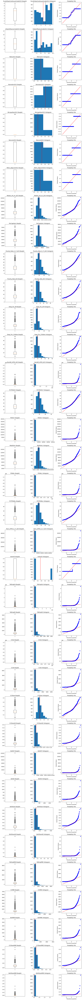

In [136]:
# Visually look for outliers
figures_per_measurement = 3 # boxplot, hist, probplot
figure_cols = figures_per_measurement
figure_rows = int(math.ceil((len(MEASUREMENT_COLS) * figures_per_measurement) / figure_cols))

# Again, a personal figure size preference, based on the number or rows and cols:
matplotlib.pyplot.figure(figsize=(4.0 * figure_cols, 4.0 * figure_rows))

hist_special_cases = {
    # The Rural / Urban Continuum Code ranges from 1..9
    'RuralUrbanContinuumCode2013': range(1, 10),

    # The Urban Influence Code ranges from 1..12
    'UrbanInfluenceCode2013': range(1, 13),

    # True/False Measures
    'Metro2013':            2,
    'Nonmetro2013':         2,
    'Micropolitan2013':     2,
    'Noncore2013':          2,
    'Metro_Adjacent2013':   2
}

# We are plotting each value individually because they are not scaled and are
# of different units.  For example, we can see from the column names that some
# are annual income (which could exceed 100k) and some are percentages.
for i in range(len(MEASUREMENT_COLS)):
    column_name = MEASUREMENT_COLS[i]
    column_values = df[column_name]

    matplotlib.pyplot.subplot(figure_rows, figure_cols, (i * figures_per_measurement) + 1, title=f'{column_name} Boxplot')
    matplotlib.pyplot.boxplot(column_values)

    matplotlib.pyplot.subplot(figure_rows, figure_cols, (i * figures_per_measurement) + 2, title=f'{column_name} Histogram')
    matplotlib.pyplot.hist(column_values, bins=hist_special_cases.get(column_name))
    matplotlib.pyplot.axvline(column_values.mean(), color='red')
    matplotlib.pyplot.axvline(column_values.median(), color='black', linestyle='dashed')

    ax = matplotlib.pyplot.subplot(figure_rows, figure_cols, (i * figures_per_measurement) + 3, title=f'{column_name} Probability')
    scipy.stats.probplot(column_values, plot=ax)

matplotlib.pyplot.tight_layout()
matplotlib.pyplot.show()

### Analysis of Outliers

* There appear to be outliers in a few columns:    
  * NumAll_inPOV_ACS    
  * POV017    
  * POVALL    
  * Num_inPOV_0_17_ACS    
  * CCEst
  * BohEST
* However, since the columns deal with absolute (vice relative) quantities, we would expect that extremely large/populous counties might appear to be outliers

In [138]:
# Let's look at the biggest outliers and see if they come from large/populous
# counties
max_std_devs = 3
max_value = df.NumAll_inPOV_ACS.mean() + (max_std_devs * df.NumAll_inPOV_ACS.std())
df[df.NumAll_inPOV_ACS > max_value].sort_values('NumAll_inPOV_ACS', ascending=False).head()

,FIPS,State,County,RuralUrbanContinuumCode2013,UrbanInfluenceCode2013,Metro2013,Nonmetro2013,Micropolitan2013,Noncore2013,Metro_Adjacent2013,...,CCShareSE,BohEST,BohSE,BohShare,BohShareSE,TotEmpRME,CCRME,BohRME,CCShareRME,BohShareRME
208,6037,CA,Los Angeles,1,1,1,0,0,0,0,...,0.00088,121620.0,1750.76,0.027018,0.00039,8617.0,6897.0,2880.0,0.00144,0.00064
614,17031,IL,Cook,1,1,1,0,0,0,0,...,0.00132,33930.0,745.90,0.013967,0.00031,6228.0,5550.0,1227.0,0.00217,0.00050
2627,48201,TX,Harris,1,1,1,0,0,0,0,...,0.00146,19300.0,654.71,0.010064,0.00034,6177.0,4872.0,1077.0,0.00240,0.00056
107,4013,AZ,Maricopa,1,1,1,0,0,0,0,...,0.00173,18810.0,671.12,0.010835,0.00039,5656.0,5201.0,1104.0,0.00285,0.00063
1855,36047,NY,Kings,1,1,1,0,0,0,0,...,0.00177,32200.0,795.14,0.029478,0.00072,4401.0,3365.0,1308.0,0.00292,0.00119


## 2.4 Data Cleaning - Conclusion

* Based on the list of biggest outliers above    
  * We can see that they all have a Rural / Urban Continuum Code of 1 which is classified as the largest of metro areas (population of 1 million or more) [(USDA.Gov, n.d. 2)](#Z.-References)    
  * The theory that the outliers are the result of extremely large/populous counties appears valid    
  * At a minimum, we **can't** conclude that the outliers must be removed.
* From the boxplots and histograms above, there are several columns that have interesting distributions:    
  * Median_HH_Inc_ACS
  * PerCapitaInc
  * Poverty_Rate_0_17_ACS
  * Poverty_Rate_ACS


---

# 3. Feature Selection

## 3.1 Graphical visualization of features 

**NOTE**: At this point, my laptop is really struggling.  I'm beginning to reduce the quantity of data displayed, even though I haven't yet begun formal dimension reduction.    

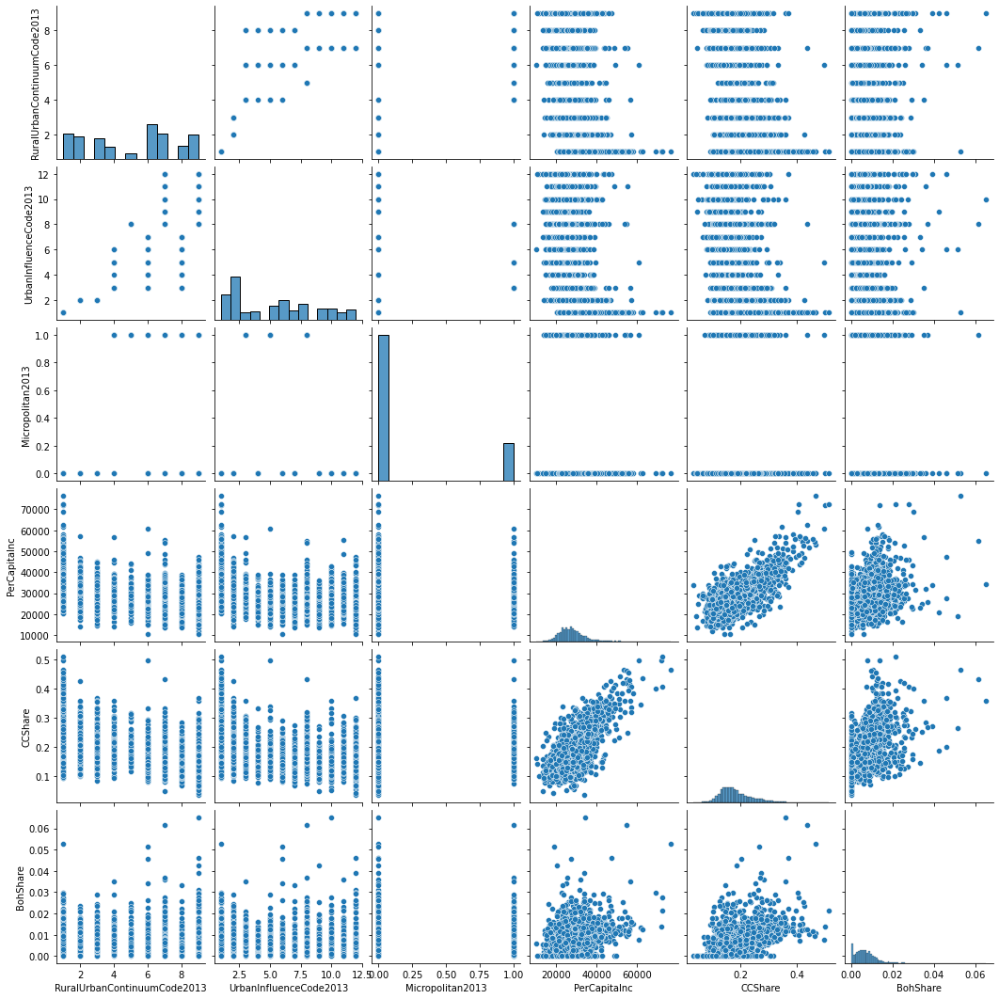

In [139]:
INITIAL_FOCUS_COLS = [
    'RuralUrbanContinuumCode2013', 
    'UrbanInfluenceCode2013',
    'Micropolitan2013',
    'PerCapitaInc',
    'CCShare',
    'BohShare'
]

sns.pairplot(df[MEASUREMENT_COLS], vars=INITIAL_FOCUS_COLS)

## 3.2 Examine the relationships within the dataset - using 2 different methods

### 3.2.1 The Pair Plot above shows a positive correlation between Per Capita Income (**`PerCapticaInc`**) and Creative Class share (**`CCShare`**)

### 3.2.2 A Correlation Matrix will numerically show the correlation

In [140]:
df_focus = df[INITIAL_FOCUS_COLS]
df_focus.corr()

,RuralUrbanContinuumCode2013,UrbanInfluenceCode2013,Micropolitan2013,PerCapitaInc,CCShare,BohShare
RuralUrbanContinuumCode2013,1.000000,0.899436,0.126035,-0.359379,-0.528553,-0.262073
UrbanInfluenceCode2013,0.899436,1.000000,0.084612,-0.293795,-0.441235,-0.202345
Micropolitan2013,0.126035,0.084612,1.000000,-0.107790,-0.059350,0.005360
PerCapitaInc,-0.359379,-0.293795,-0.107790,1.000000,0.733708,0.420864
CCShare,-0.528553,-0.441235,-0.059350,0.733708,1.000000,0.556755
BohShare,-0.262073,-0.202345,0.005360,0.420864,0.556755,1.000000


### 3.2.3 A Heatmap can also be used to examine relationships

<AxesSubplot:>

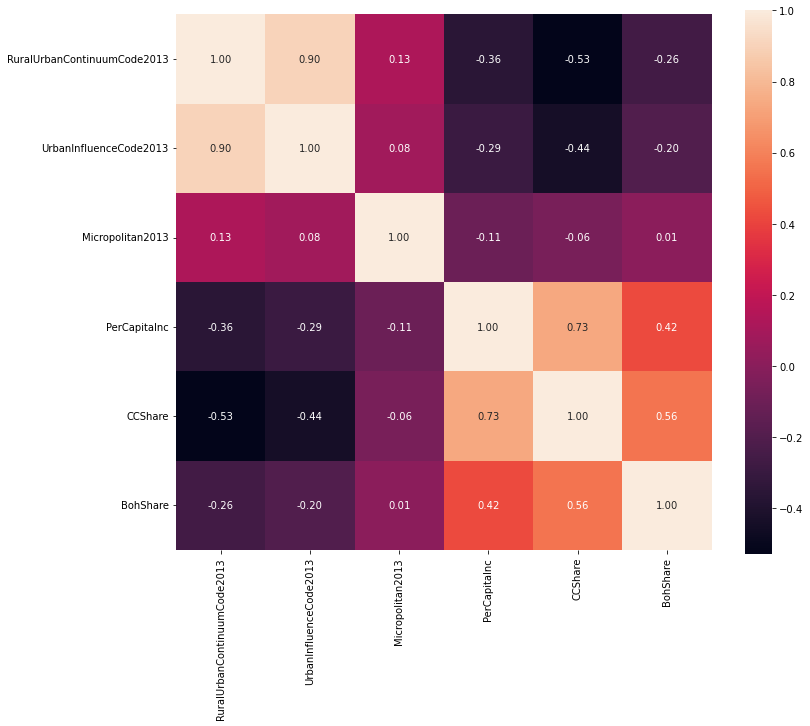

In [141]:
f, ax = matplotlib.pyplot.subplots(figsize=(12, 10))
sns.heatmap(df_focus.corr(), square=True, annot=True, fmt='.2f')

## 3.3 Reduction of the dimensionality of the dataset

As previously mentioned, I've already begun to display only subsets of the data.

---

# 4. Insights and Findings

While exploring the USDA and Census sites, I found reference to Richard Florida's *Rise of the Creative Class* concept [(USDA, n.d. 2)](#Z.-References).

> urban development now depends on novel combinations of knowledge and ideas, that certain occupations specialize in this task, that people in these occupations are drawn to areas providing a high quality of life, and that the essential development strategy is to create an environment that attracts and retains these workers. While developed with urban areas in mind, this thesis may be particularly relevant in rural areas, which lose much of their young talent as high school graduates leave for college, the armed forces, or "city lights."

The heatmap and correlation matrix above don't show a strong inverse relationship between Rural/Urban Continuum Code and Creative Class share (only -0.53).

However, there are other ways to analyze this relationship.  The following scatterplot illustrates the three-way relationship between the Rural/Urban Continuum Code, Per Capita Income, and the county's share of Creative Class.

* The Rural/Urban Continuum Code is plotted on the Y-axis, with 1 indicating a large metropolitan area and 9 indiating the smallest of rural areas
* Per Capita Income is plotted along the X-axis in USD
* The Creative Class share is depicted via hue and size, with a larger share of the Creative Class denoted by darker hue and larger markers.

This view of the data shows a definite concentration of the Creative Class in ***large metropolitan areas*** with ***high Per Capita Income***.

<AxesSubplot:xlabel='PerCapitaInc', ylabel='RuralUrbanContinuumCode2013'>

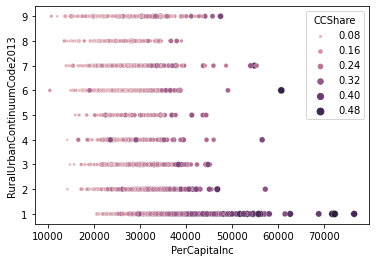

In [142]:
sns.scatterplot(data=df, x='PerCapitaInc', y='RuralUrbanContinuumCode2013', hue='CCShare', size='CCShare', sizes=(0, 50))


---

# II. References

[Census.Gov (n.d. 1).  Our Surveys & Programs > American Community Survey](https://www.census.gov/programs-surveys/acs/)

[Census.Gov (n.d. 2).  Our Surveys & Programs > Geography Program > Technical Documentation > Changes to Counties and County Equivalents: 1970-Present](https://www.census.gov/programs-surveys/geography/technical-documentation/county-changes.1980.html)

[Data.Gov (2021). USDA Economic Research Service > Atlas of Rural and Small-Town America](https://catalog.data.gov/dataset/atlas-of-rural-and-small-town-america)

[Jennings, Ken (2013, May).  The Surprising Hitory of Kalaupapa, Hawaii](https://www.cntraveler.com/stories/2013-05-06/kalawao-county-hawaii-maphead-ken-jennings)

[Regis.Edu (n.d.) MSDS 650 Data Analytics > Week 3: Exploratory Data Analysis (EDA) > 3_Assignment](https://worldclass.regis.edu/d2l/le/content/277913/viewContent/4049524/View)

[USDA.Gov (n.d. 1). USDA Economic Research Service > Data Products > Atlas of Rural and Small-Town America > Documentation](https://www.ers.usda.gov/data-products/atlas-of-rural-and-small-town-america/documentation/#rucc2010)

[USDA.Gov (n.d. 2). USDA Economic Research Service > Data Products > Creative Class County Codes > Documentation](https://www.ers.usda.gov/data-products/creative-class-county-codes/documentation/)

[USDA.Gov (n.d. 3).  USDA Economic Research Service > Data Products > Rural-Urban Continuum Codes](https://www.ers.usda.gov/data-products/rural-urban-continuum-codes/documentation/)


# III. Definitions

* *FIPS County Code*    
  Federal Information Processing Standard (FIPS).  Standard was withdrawn in 2008.
* *RuralUrbanContinuumCode2013* [(USDA.Gov, n.d. 3)](#II.-References)    
  9-level classification of counties by metro-nonmetro status, location, and urban size
  1. Counties in metro areas of 1 million population or more
  2. Counties in metro areas of 250,000 to 1 million population
  3. Counties in metro areas of fewer than 250,000 population
  4. Urban population of 20,000 or more, adjacent to a metro area
  5. Urban population of 20,000 or more, not adjacent to a metro area
  6. Urban population of 2,500 to 19,999, adjacent to a metro area
  7. Urban population of 2,500 to 19,999, not adjacent to a metro area
  8. Completely rural or less than 2,500 urban population, adjacent to a metro area
  9. Completely rural or less than 2,500 urban population, not adjacent to a metro area
